In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import calendar
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from sklearn.preprocessing import StandardScaler, PolynomialFeatures, MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.model_selection import KFold, cross_val_predict
from sklearn.metrics import r2_score

from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge, Lasso

import warnings
warnings.filterwarnings('ignore')

In [2]:
def plot_results(Y_test,y_test_pred):
    error_list = [abs(i-j) for i,j in zip(Y_test,y_test_pred)]
    result_df = pd.DataFrame(zip(Y_test,y_test_pred,error_list),columns=(["Ground Truth","Prediction","Absolute Error"]))
    result_df = result_df[(result_df["Ground Truth"] > 0) & (result_df["Ground Truth"] < 150)]
    
    fig = px.scatter(result_df,x="Ground Truth", y="Prediction",width=1500, height=600,
                     labels=dict(x="Ground Truth", y="Prediction"), color="Absolute Error")


    fig.update_xaxes(title_font=dict(size=35, color='black'))
    fig.update_yaxes(title_font=dict(size=35, color='black'))
    fig.update_xaxes(zeroline=False)
    fig.update_yaxes(zeroline=False)

    fig.update_xaxes(range=[0, 100])
    fig.update_yaxes(range=[0, 120])

    title="Regression Prediction Results compared to Ground Truth"

    fig.show()
    
def data_types(df):
    return pd.DataFrame(df.dtypes.value_counts(),columns=(["count"]))

def check_num_OHC(df):
    categorical_cols = df.columns[df.dtypes == object]
    num_OHC_cols = pd.DataFrame(df[categorical_cols]
                .apply(lambda x: x.nunique())
                .sort_values(ascending=False), columns=(["count"]))
    
    #if column only has one category, column is irrelevant for encoding
    num_OHC_cols = num_OHC_cols["count"].loc[num_OHC_cols["count"]>=2]
    
    num_OHC_cols -=1
    
    return num_OHC_cols.sum()

def create_OHC_dataframe(df):
    
    #create copy of dataframe
    df_OHC = df.copy()
    
    #create encoder objects
    le = LabelEncoder()
    ohc = OneHotEncoder()

    #create filter for categorical columns
    categorical_cols = df.columns[df.dtypes == object]
    num_OHC_cols = (df[categorical_cols]
                    .apply(lambda x: x.nunique())
                    .sort_values(ascending=False))

    for col in num_OHC_cols.index:

        # Integer encode the string categories
        encoded_cols = le.fit_transform(df_OHC[col]).astype(np.int)

        # Remove the original column from the dataframe
        df_OHC = df_OHC.drop(col, axis=1)

        # One hot encode the data--this returns a sparse array
        OHC_cols = ohc.fit_transform(encoded_cols.reshape(-1,1))

        # Create unique column names
        num_cols = OHC_cols.shape[1]
        col_names = ['_'.join([col, str(x)]) for x in range(num_cols)]

        # Create the new dataframe
        new_df = pd.DataFrame(OHC_cols.toarray(), 
                              index=df_OHC.index, 
                              columns=col_names)

        # Append the new data to the dataframe
        df_OHC = pd.concat([df_OHC, new_df], axis=1)

    return df_OHC

def null_values(dataframe):
    column_list = dataframe.columns.values.tolist()
    dict = {}
    for column in column_list:
        if dataframe[str(column)].isnull().sum() > 0:
            dict[column] = dataframe[str(column)].isnull().sum()
            percentage_missing = dataframe[str(column)].isnull().sum()/len(dataframe)*100
            dict[column] = np.append(dict[column], percentage_missing)
    return pd.DataFrame.from_dict(dict,orient="index", columns = ['absolute', 'percentage'])

In [3]:
df = pd.read_csv("uber_preprocessed.csv")
df.drop("Unnamed: 0",inplace=True,axis=1)

# Drop Columns that are not relevant for prediction
df.drop(["date","time","minute","second"],axis=1,inplace=True)

df.year = df.year.apply(lambda x: str(x))
df.month = df.month.apply(lambda x: calendar.month_name[x])
df.day_of_week = df.day_of_week.apply(lambda x: calendar.day_name[x])
df.day = df.day.apply(lambda x: str(x))
#df.hour = df.hour.apply(lambda x: str(x))

In [4]:
df.head()

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,year,month,day,hour,day_of_week,distance
0,7.5,-73.999817,40.738354,-73.999512,40.723217,1,2015,May,7,19,Thursday,1.683851
1,7.7,-73.994355,40.728225,-73.994710,40.750325,1,2009,July,17,20,Friday,2.458361
2,12.9,-74.005043,40.740770,-73.962565,40.772647,1,2009,August,24,21,Monday,5.037958
3,5.3,-73.976124,40.790844,-73.965316,40.803349,3,2009,June,26,8,Friday,1.662205
4,16.0,-73.925023,40.744085,-73.973082,40.761247,5,2014,August,28,17,Thursday,4.476855


In [5]:
df = create_OHC_dataframe(df)

In [6]:
target = "fare_amount"
features = [col for col in df.columns.tolist() if col != "fare_amount"]

X = df[features]
Y = df[target]

In [7]:
X_train, X_test, Y_train, Y_test = train_test_split(X,Y,test_size=0.33, random_state=42)

In [8]:
LR = LinearRegression()
RR = Ridge(alpha=0.001)
Lasso = Lasso(alpha=0.0001)

In [9]:
#Scaler
scaler = StandardScaler()

In [10]:
LR_estimator = Pipeline([
    ("scaler", scaler),
    ("make_higher_degree", PolynomialFeatures(degree=2)),
    ("Linear Regression", LR)
])

In [11]:
RR_estimator = Pipeline([
    ("scaler", scaler),
    ("make_higher_degree", PolynomialFeatures(degree=2)),
    ("Ridge Regression", RR)
])

In [12]:
Lasso_estimator = Pipeline([
    ("scaler", scaler),
    ("make_higher_degree", PolynomialFeatures(degree=2)),
    ("Lasso Regression", Lasso)
])

In [13]:
model_LR = LR_estimator.fit(X_train,Y_train)

In [14]:
model_RR = RR_estimator.fit(X_train,Y_train)

In [15]:
model_Lasso = Lasso_estimator.fit(X_train,Y_train)

In [16]:
LR_y_train_pred = model_LR.predict(X_train)
LR_y_test_pred = model_LR.predict(X_test)

RR_y_train_pred = model_RR.predict(X_train)
RR_y_test_pred = model_RR.predict(X_test)

Lasso_y_train_pred = model_Lasso.predict(X_train)
Lasso_y_test_pred = model_Lasso.predict(X_test)

In [17]:
# Error DataFrame
error_df = []
error_df.append(pd.Series({'train': mean_squared_error(Y_train, LR_y_train_pred),
                           'test' : mean_squared_error(Y_test,  LR_y_test_pred)},
                           name='Linear Regression'))
error_df.append(pd.Series({'train': mean_squared_error(Y_train, RR_y_train_pred),
                           'test' : mean_squared_error(Y_test,  RR_y_test_pred)},
                           name='Ridge Regression'))
error_df.append(pd.Series({'train': mean_squared_error(Y_train, Lasso_y_train_pred),
                           'test' : mean_squared_error(Y_test,  Lasso_y_test_pred)},
                           name='Lasso Regression'))
pd.DataFrame(error_df)

,train,test
Linear Regression,18.516936,23.585340
Ridge Regression,18.494429,23.551868
Lasso Regression,18.518565,23.717157


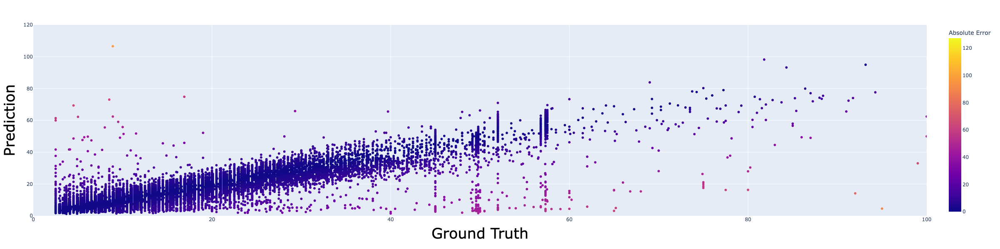

In [18]:
plot_results(Y_test,LR_y_test_pred)

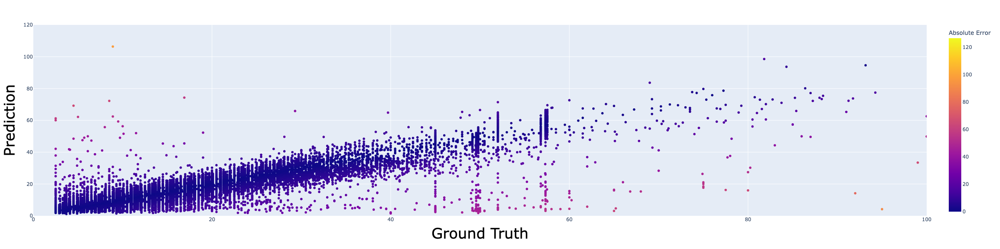

In [19]:
plot_results(Y_test,RR_y_test_pred)

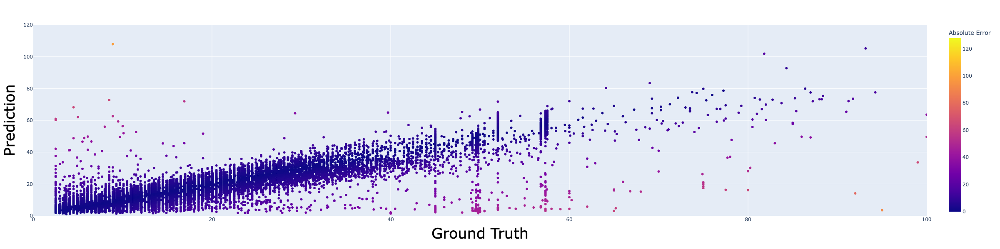

In [20]:
plot_results(Y_test,Lasso_y_test_pred)

In [21]:
# let's look at the absolute value of coefficients for each model

coefficients = pd.DataFrame()
coefficients['linear regression'] = LR.coef_.ravel()
coefficients['ridge regression'] = RR.coef_.ravel()
coefficients['lasso regression'] = Lasso.coef_.ravel()
coefficients = coefficients.applymap(abs)

coefficients.describe()  # Huge difference in scale between non-regularized vs regularized regression

,linear regression,ridge regression,lasso regression
count,2.145000e+03,2145.000000,2145.000000
mean,1.433648e+10,0.276673,0.019018
std,3.271867e+10,4.481424,0.192772
min,1.525879e-05,0.000000,0.000000
25%,2.533091e+09,0.000612,0.000000
50%,7.013054e+09,0.008402,0.004169
75%,1.619581e+10,0.020779,0.015998
max,7.931441e+11,109.275836,8.715641


In [22]:
coefficients

,linear regression,ridge regression,lasso regression
0,3.957793e+10,0.000000,0.000000
1,2.350507e+00,2.304118,0.117554
2,1.310025e+00,1.292148,0.084626
3,2.236182e+00,2.201852,0.193005
4,1.321333e+00,1.297298,0.243878
...,...,...,...
2140,3.991700e+08,0.006675,0.000000
2141,2.537215e+09,0.011260,0.000000
2142,3.949596e+09,0.003963,0.000000
2143,1.636202e+09,0.005854,0.000000
